# Import Libraries and Modules

In [1]:
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams["animation.html"] = "jshtml"
plt.ioff()

from matplotlib.figure import Figure
from matplotlib.animation import FuncAnimation

import modules.ElbowManipulator as ElbowManipulator
import modules.ManipulatorController as ManipulatorController

# Setup Robot and Controller

### Assumptions
- No friction
- Motors have negligible mass
- Links are made up of uniform cross section rods

In [2]:
robot		= ElbowManipulator.ElbowManipulator()
controller	= ManipulatorController.ManipulatorController(frequency=1E3) # Frequency at which controller loop runs

# Least count of measuring devices used to measure
# link weights and lengths
lc_weight = 1E-3	# kg
lc_length = 1E-3	# m

# Set mass/length of links in actual robot
robot.setLinkProperties(link_num=1, mass=0.250 + lc_weight*(np.random.random(1)[0] - 0.5), length=0.600 + lc_length*(np.random.random(1)[0] - 0.5))
robot.setLinkProperties(link_num=2, mass=0.200 + lc_weight*(np.random.random(1)[0] - 0.5), length=0.480 + lc_length*(np.random.random(1)[0] - 0.5))

# Set mass/length of links as measured for the controller dynamics
controller.system.setLinkProperties(link_num=1, mass=0.250, length=0.600)
controller.system.setLinkProperties(link_num=2, mass=0.200, length=0.480)

# # Set angle limits of joints
# robot.setJointLimits(joint_num= 1, min_angle=0,			max_angle=np.pi)
# robot.setJointLimits(joint_num= 2, min_angle=-0.5*np.pi,	max_angle=1.5*np.pi)
# controller.system.setJointLimits(joint_num= 1, min_angle=0,			max_angle=np.pi)
# controller.system.setJointLimits(joint_num= 2, min_angle=-0.5*np.pi,	max_angle=1.5*np.pi)

# Task 1

## Trajectory

In [3]:
# Total simulation time
sim_time = 10	# s

# Circle
t = np.linspace(0, sim_time, 75)
x = 0.3 * np.cos(0.2 * np.pi * t)
y = 0.5 + 0.3 * np.sin(0.2 * np.pi * t)

# Set up Trajectory Object
trajectory = ManipulatorController.Trajectory(t, x, y)
trajectory.generateTargetStates(controller)

## Angle Control

In [4]:
# Angle control loop
def angleControl(t:float) -> np.ndarray :
	'''	Retrieves the current state of the manipulator
		and sets the desired angle at the joints.
		Returns [q1, q2]	'''
	
	controller.state.setState(robot.getState())
	
	next_state = controller.angleControl(t, trajectory.getTargetState(t))

	robot.setState(t, next_state)
	
	# Values at indices 0 and 1 represent q1 and q2 respectively
	return next_state[:2]

### Setting up Visualization Objects

In [5]:
frame_rate = 60.0	# Hz
frame_interval = 1 / frame_rate	# seconds

figure_1a = plt.figure(figsize=[10, 8])
bot_axes, q_axes = figure_1a.subplots(2, 1, gridspec_kw={'height_ratios': [3, 1]})

robot.setUpPlot(bot_axes)
target_point, = bot_axes.plot([], [], 'o', markersize=3, label='Target Position')

bot_axes.legend()
bot_axes.axis('scaled')
bot_axes.set_axis_off()

t_array  = list()
q1_array = list()
q2_array = list()

q1_plot, = q_axes.plot(t_array, q1_array, label=r'$q_1$')
q2_plot, = q_axes.plot(t_array, q2_array, label=r'$q_2$')

q_axes.legend()
q_axes.set_xlim([0, sim_time])
q_axes.set_ylim([-np.pi/2, 3*np.pi/2])

def initFrame1a() -> tuple :

	robot.setState(0, trajectory.getTargetState(0))
	controller.state.setState(trajectory.getTargetState(0))

	x, y = trajectory.getTargetPosition(0)
	target_point.set_data(x, y)

	t_array.clear()
	q1_array.clear()
	q2_array.clear()

	q1_plot.set_data(t_array, q1_array)
	q2_plot.set_data(t_array, q2_array)

	return robot.updatePlot(), target_point, q1_plot, q2_plot,

def updateFrame1a(time:float) -> tuple :

	for t in np.arange(time, time + frame_interval, controller.time_step) :

		q = angleControl(t)

	x, y = trajectory.getTargetPosition(time)
	target_point.set_data(x, y)

	t_array.append(time)
	q1_array.append(q[0])
	q2_array.append(q[1])

	q1_plot.set_data(t_array, q1_array)
	q2_plot.set_data(t_array, q2_array)

	return robot.updatePlot(), target_point, q1_plot, q2_plot

animation_1a = FuncAnimation(
	figure_1a,
	updateFrame1a,
	np.arange(0, sim_time, frame_interval),
	interval=frame_interval * 1E3,
	init_func=initFrame1a,
	blit=True
)

### Animation

In [6]:
animation_1a

## Torque Control

In [7]:
F = lambda t, state : np.zeros(2)
robot.setF(F)

# Torque control loop
def torqueControl(t:float) -> np.ndarray :
	'''	Retrieves the current state of the manipulator
		and sets the required torque at the joints.
		Returns [tau1, tau2]	'''
	
	controller.state.setState(robot.getState())
	
	tau = controller.torqueControl(t, trajectory.getTargetState(t), F)

	robot.setTau(tau)

	# Solve the differential equations for 1 time step of the controller
	robot.advanceTime(controller.time_step)
	
	# Values at indices 0 and 1 represent q1 and q2 respectively
	return tau

### Setting up Visualization objects

In [8]:
### Setting up Visualization Objects
frame_rate = 60.0	# Hz
frame_interval = 1 / frame_rate	# seconds

figure_1b = plt.figure(figsize=[10, 8])
bot_axes, tau_axes = figure_1b.subplots(2, 1, gridspec_kw={'height_ratios': [3, 1]})

robot.setUpPlot(bot_axes)
target_point, = bot_axes.plot([], [], 'o', markersize=3, label='Target Position')

bot_axes.legend()
bot_axes.axis('scaled')
bot_axes.set_axis_off()

time_array = list()
tau1_array = list()
tau2_array = list()

tau1_plot, = tau_axes.plot(time_array, tau1_array, label=r'$\tau_1$')
tau2_plot, = tau_axes.plot(time_array, tau2_array, label=r'$\tau_2$')

tau_axes.legend()
tau_axes.set_xlim([0, sim_time])
tau_axes.set_ylim([-10, 10])

def initFrame1b() -> tuple :

	robot.setState(0, trajectory.getTargetState(0))
	controller.state.setState(trajectory.getTargetState(0))

	x, y = trajectory.getTargetPosition(0)
	target_point.set_data(x, y)

	time_array.clear()
	tau1_array.clear()
	tau2_array.clear()

	tau1_plot.set_data(time_array, tau1_array)
	tau2_plot.set_data(time_array, tau2_array)

	return robot.updatePlot(), target_point, tau1_plot, tau2_plot,

def updateFrame1b(time:float) -> tuple :

	for t in np.arange(time, time + frame_interval, controller.time_step) :

		tau = torqueControl(t)

	x, y = trajectory.getTargetPosition(time)
	target_point.set_data(x, y)

	time_array.append(time)
	tau1_array.append(tau[0])
	tau2_array.append(tau[1])

	tau1_plot.set_data(time_array, tau1_array)
	tau2_plot.set_data(time_array, tau2_array)

	return robot.updatePlot(), target_point, tau1_plot, tau2_plot

animation_1b = FuncAnimation(
	figure_1b,
	updateFrame1b,
	np.arange(0, sim_time, frame_interval),
	interval=frame_interval * 1E3,
	init_func=initFrame1b,
	blit=True
)

### Animation

In [9]:
animation_1b

# Task 2

### Trajectory

In [10]:
wall_position	= [0.0, 0.75]	# m
force			= [30.0, 40.0]	# N

# Total simulation time
sim_time = 2

t = np.linspace(0, sim_time, 100)
x = np.append(
	np.linspace(0.75, wall_position[0], t.shape[0] // 2),	# Move to the desired position in 1 s
	np.ones(t.shape[0] // 2) * wall_position[0]				# Remain at wall position for 1 s
)
y = np.append(
	np.linspace(0.25, wall_position[1], t.shape[0] // 2),	# Move to the desired position in 1 s
	np.ones(t.shape[0] // 2) * wall_position[1]				# Remain at wall position for 1 s
)

# Set up trajectory object
trajectory = ManipulatorController.Trajectory(t, x, y)
trajectory.generateTargetStates(controller)

# Set up Forcing function
def F(t:float, state:np.ndarray) -> np.ndarray :

	if all(state[:2] >= wall_position) :
		
		return np.array(force)

	else : return np.zeros(2)

robot.setF(F)

### Torque Control

In [11]:
# Torque control loop
def torqueControl(t:float) -> np.ndarray :
	'''	Retrieves the current state of the manipulator
		and sets the required torque at the joints.
		Returns [tau1, tau2]	'''
	
	controller.state.setState(robot.getState())
	
	tau = controller.torqueControl(t, trajectory.getTargetState(t), F)

	robot.setTau(tau)

	# Solve the differential equations for 1 time step of the controller
	robot.advanceTime(controller.time_step)
	
	# Values at indices 0 and 1 represent q1 and q2 respectively
	return tau

### Setting up Visualization objects

In [14]:
frame_rate = 60.0	# Hz
frame_interval = 1 / frame_rate	# seconds

figure_2 = plt.figure(figsize=[10, 8])
bot_axes, tau_axes = figure_2.subplots(2, 1, gridspec_kw={'height_ratios': [3, 1]})

robot.setUpPlot(bot_axes)
target_point, = bot_axes.plot([], [], 'o', markersize=3, label='Target Position')

bot_axes.legend()
bot_axes.axis('scaled')
bot_axes.set_axis_off()

time_array = list()
tau1_array = list()
tau2_array = list()

tau1_plot, = tau_axes.plot(time_array, tau1_array, label=r'$\tau_1$')
tau2_plot, = tau_axes.plot(time_array, tau2_array, label=r'$\tau_2$')

tau_axes.legend()
tau_axes.set_xlim([0, sim_time])
tau_axes.set_ylim([-50, 25])

def initFrame2() -> tuple :

	robot.setState(0, trajectory.getTargetState(0))
	controller.state.setState(trajectory.getTargetState(0))

	x, y = trajectory.getTargetPosition(0)
	target_point.set_data(x, y)

	time_array.clear()
	tau1_array.clear()
	tau2_array.clear()

	tau1_plot.set_data(time_array, tau1_array)
	tau2_plot.set_data(time_array, tau2_array)

	return robot.updatePlot(), target_point, tau1_plot, tau2_plot,

def updateFrame2(time:float) -> tuple :

	for t in np.arange(time, time + frame_interval, controller.time_step) :

		tau = torqueControl(t)

	x, y = trajectory.getTargetPosition(time)
	target_point.set_data(x, y)

	time_array.append(time)
	tau1_array.append(tau[0])
	tau2_array.append(tau[1])

	tau1_plot.set_data(time_array, tau1_array)
	tau2_plot.set_data(time_array, tau2_array)

	return robot.updatePlot(), target_point, tau1_plot, tau2_plot

animation_2 = FuncAnimation(
	figure_2,
	updateFrame2,
	np.arange(0, sim_time, frame_interval),
	interval=frame_interval * 1E3,
	init_func=initFrame2,
	blit=True
)

### Animation

In [15]:
animation_2

# Task 3

### Initial Conditions

In [16]:
# Total simulation time
sim_time = 10

# Spring stiffness
k = 10	# N / m
# Spring point of attachment
origin_spring = np.array([
	0.5,	# x_0 in m	
	0.5		# y_0 in m
])

# End-Effector Initial State
init_state = np.array([
	0.4,	# x in m
	0.4,	# y in m
	0.0,	# xdot in m/s
	0.0		# ydot in m/s
])

# Converting to joint space
initial_state = ElbowManipulator.ElbowManipulatorState()
initial_state.setQ(controller.q(init_state[0], init_state[1])[0])
initial_state.setQdot(np.matmul(initial_state.J(controller.system), init_state[2:]))

In [17]:
realForce = lambda t, state : np.zeros(2)
robot.setF(realForce)

def forceSpring(t:float, state:np.ndarray) -> np.ndarray :

	return - k * (state[:2] - origin_spring)

# Torque control loop
def torqueControl(t:float) -> np.ndarray :
	'''	Retrieves the current state of the manipulator
		and sets the required torque at the joints.
		Returns [tau1, tau2]	'''
	
	controller.state.setState(robot.getState())
	
	tau = controller.torqueControl(t, controller.state, forceSpring)

	robot.setTau(tau)

	# Solve the differential equations for 1 time step of the controller
	robot.advanceTime(controller.time_step)
	
	# Values at indices 0 and 1 represent q1 and q2 respectively
	return tau

### Setting up Visualization objects

In [18]:
frame_rate = 60.0	# Hz
frame_interval = 1 / frame_rate	# seconds

figure_3 = plt.figure(figsize=[10, 8])
bot_axes, tau_axes = figure_3.subplots(2, 1, gridspec_kw={'height_ratios': [3, 1]})

robot.setUpPlot(bot_axes)
spring_point, = bot_axes.plot([], [], 'o', markersize=3, label='Spring Origin')

bot_axes.legend()
bot_axes.axis('scaled')
bot_axes.set_axis_off()

time_array = list()
tau1_array = list()
tau2_array = list()

tau1_plot, = tau_axes.plot(time_array, tau1_array, label=r'$\tau_1$')
tau2_plot, = tau_axes.plot(time_array, tau2_array, label=r'$\tau_2$')

tau_axes.legend()
tau_axes.set_xlim([0, sim_time])
tau_axes.set_ylim([-2, 2])

def initFrame3() -> tuple :

	robot.setState(0, np.asarray(initial_state))
	controller.state.setState(initial_state)

	spring_point.set_data(origin_spring[0], origin_spring[1])

	time_array.clear()
	tau1_array.clear()
	tau2_array.clear()

	tau1_plot.set_data(time_array, tau1_array)
	tau2_plot.set_data(time_array, tau2_array)

	return robot.updatePlot(), spring_point, tau1_plot, tau2_plot,

def updateFrame3(time:float) -> tuple :

	for t in np.arange(time, time + frame_interval, controller.time_step) :

		tau = torqueControl(t)

	spring_point.set_data(origin_spring[0], origin_spring[1])

	time_array.append(time)
	tau1_array.append(tau[0])
	tau2_array.append(tau[1])

	tau1_plot.set_data(time_array, tau1_array)
	tau2_plot.set_data(time_array, tau2_array)

	return robot.updatePlot(), spring_point, tau1_plot, tau2_plot

animation_3 = FuncAnimation(
	figure_3,
	updateFrame3,
	np.arange(0, sim_time, frame_interval),
	interval=frame_interval * 1E3,
	init_func=initFrame3,
	blit=True
)

In [19]:
animation_3

# Task 4

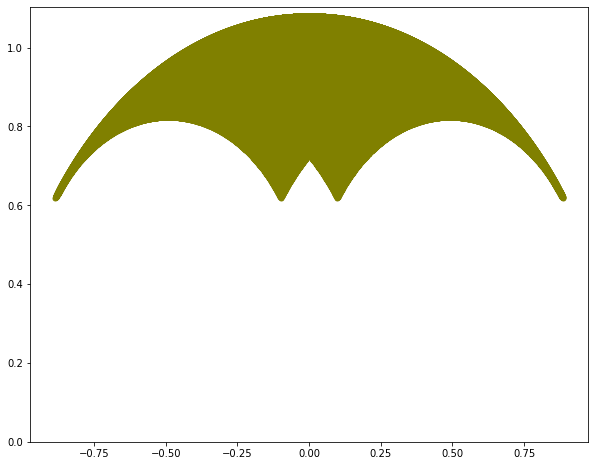

In [39]:
figure_4 = plt.figure(figsize=[10, 8])
ax = figure_4.add_subplot(1, 1, 1)

l1 = controller.system.l(1)
l2 = controller.system.l(2)

rad35, rad145 = np.deg2rad([35, 145])
q1 = np.linspace(rad35, rad145, 1000)
q2 = np.linspace(rad35, rad145, 1000)

Q1, Q2 = np.meshgrid(q1, q2)

E_x = lambda q1, q2 : l1 * np.cos(q1) + l2 * np.cos(q2)
E_y = lambda q1, q2 : l1 * np.sin(q1) + l2 * np.sin(q2)

ax.plot(E_x(Q1,  Q2),  E_y(Q1,  Q2), 'o', c='olive', markersize=5)

ax.set_ylim(0)

figure_4